In [1]:
import networkx as nx
import powerlaw as pl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from collections import Counter 

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [2]:
G = nx.read_edgelist('lastfm_asia_edges.txt', delimiter=',')

In [3]:
print(G)
# G.in_degree()

Graph with 7624 nodes and 27806 edges


In [4]:
def generate_ccdf(G):
    dd = Counter(dict(G.degree).values())
    dd = pd.DataFrame(list(dd.items()), columns = ("k", "count")).sort_values(by = "k")
    ccdf = dd.sort_values(by = "k", ascending = False)
    ccdf["cumsum"] = ccdf["count"].cumsum()
    ccdf["ccdf"] = ccdf["cumsum"] / ccdf["count"].sum()
    ccdf = ccdf[["k", "ccdf"]].sort_values(by = "k")

    results = pl.Fit(ccdf["ccdf"])
    k_min = ccdf[ccdf["ccdf"] == results.power_law.xmin]["k"]
    print("Powerlaw CCDF Fit: %1.4f x ^ -%1.4f (k_min = %d)" % (10 ** results.power_law.Kappa, 
                                                                results.power_law.alpha, k_min))

   # Let's plot the best fit.
    ccdf["fit"] = (10 ** results.power_law.Kappa) * (ccdf["k"] ** -results.power_law.alpha)
    ax = plt.gca()
    ccdf.plot(kind = "line", x = "k", y = "ccdf", color = "#e41a1c", loglog = True, ax = ax)
    ccdf.plot(kind = "line", x = "k", y = "fit", color = "#377eb8", loglog = True, ax = ax)
    plt.ylim(bottom=0.0001)
    return None

In [5]:
def logscatter(G):
    d = dict(G.degree)
    # turn into a count of degree (the values of the dict)
    counter = Counter(d.values())
    # Make it into a dataframe
    counter = pd.DataFrame(list(counter.items()), columns = ("k", "count")).sort_values(by = "k")
    plt.scatter(np.log2(counter['k']), np.log2(counter['count']), c = 'blue', s=10, alpha=0.5)
    plt.title("log-log degree distr.")
    plt.savefig("loglog_degree_distribution.png")
    plt.show()
    return None

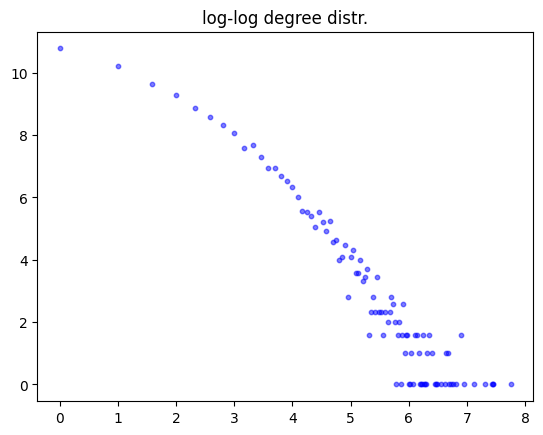

In [6]:
logscatter(G)

Calculating best minimal value for power law fit
Powerlaw CCDF Fit: 11.0660 x ^ -1.5454 (k_min = 69)


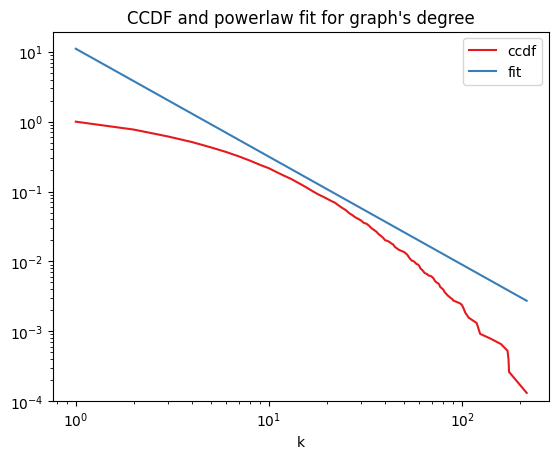

In [7]:
generate_ccdf(G)
plt.title("CCDF and powerlaw fit for graph's degree");

In [8]:
#global cluster coef = transitivity
trans = nx.transitivity(G)
print(f"Transitivity for full network: {trans}")

#nx.clustering = local cluster coef
cc = nx.clustering(G)
# print(f"CC for full network: {cc}")

#average cc
avgcc = sum(cc.values())/len(cc.values())
print(f"Average clustering coeff.: {avgcc}")

# def p(Graph):
#     return len(Graph.edges) / ((len(Graph.nodes) * (len(Graph.nodes)-1)) / 2)

# print("The parameter p for the graph: ", p(G))

Transitivity for full network: 0.178622548153384
Average clustering coeff.: 0.2194184243270858


In [9]:
#taking the largest strongly connected component
scc = max(nx.connected_components(G), key=len)

In [10]:
len(scc)

7624

In [11]:
ass = nx.degree_assortativity_coefficient(G)
ass

0.01707317256063152

In [12]:
from networkx.algorithms.community import greedy_modularity_communities
from networkx.algorithms.community.quality import modularity

communities = list(greedy_modularity_communities(G))

community_dict = {}
for i, comm in enumerate(communities):
    for node in comm:
        community_dict[node] = i

modularity_value = modularity(G, [comm for comm in communities])
print("Modularity:", modularity_value)
communities

KeyboardInterrupt: 

In [ ]:
import community
partition = community.best_partition(G)

communities = {}
for node, comm_id in partition.items():
    if comm_id not in communities:
        communities[comm_id] = [node]
    else:
        communities[comm_id].append(node)

cumnum = list(communities.keys())
print("Communities:", len(communities.keys()))
# cumnum.sort()
# print(cumnum)


Communities: 27


{0: [0,
  1,
  261,
  262,
  264,
  265,
  266,
  267,
  268,
  269,
  270,
  271,
  272,
  273,
  274,
  361,
  362,
  363,
  364,
  365,
  366,
  367,
  368,
  369,
  370,
  371,
  372,
  373,
  375,
  376,
  377,
  378,
  379,
  380,
  381,
  382,
  383,
  384,
  385,
  451,
  452,
  453,
  454,
  455,
  530,
  606,
  607,
  608,
  609,
  610,
  611,
  612,
  613,
  614,
  615,
  616,
  617,
  618,
  619,
  620,
  621,
  624,
  625,
  626,
  627,
  628,
  629,
  873,
  874,
  875,
  876,
  877,
  878,
  933,
  934,
  935,
  971,
  1031,
  1166,
  1167,
  1168,
  1169,
  1170,
  1171,
  1304,
  1305,
  1307,
  1499,
  1589,
  1590,
  1591,
  1592,
  1593,
  1594,
  1595,
  1596,
  1631,
  1632,
  1671,
  1672,
  1673,
  1674,
  1675,
  1676,
  1677,
  1712,
  1834,
  1835,
  1836,
  1837,
  1838,
  1839,
  1840,
  1841,
  1842,
  1843,
  1844,
  1845,
  1846,
  1847,
  1848,
  1849,
  1850,
  1851,
  1852,
  1853,
  1854,
  1855,
  1856,
  1868,
  1869,
  1870,
  1871,
  1872,
  1968

In [ ]:
from networkx.algorithms import community
high_deg_node_dict = {}
for i in range(len(cumnum)):
    target_community = i
    nodes_in_community = [node for node, comm_id in partition.items() if comm_id == target_community]
    degrees = G.degree(nodes_in_community)
    node_with_highest_degree = max(degrees, key=lambda x: x[1])
    high_deg_node_dict[i] = node_with_highest_degree[0]
    #print("Node with the highest degree in the community:", node_with_highest_degree[0])

print("Highest degree nodes in each respective community: ", high_deg_node_dict)

Highest degree nodes in each respective community:  {0: '1792', 1: '4811', 2: '4785', 3: '6241', 4: '3530', 5: '5117', 6: '2854', 7: '4033', 8: '7237', 9: '1325', 10: '524', 11: '6101', 12: '6703', 13: '2805', 14: '5851', 15: '3643', 16: '4356', 17: '1749', 18: '3571', 19: '2160', 20: '1674', 21: '7199', 22: '6817', 23: '5461', 24: '7501', 25: '7557', 26: '7480', 27: '2019', 28: '1857'}


In [ ]:
community_sizes = {comm_id: sum(1 for node in partition.values() if node == comm_id) 
                  for comm_id in set(partition.values())}
largest_community_id = max(community_sizes, key=community_sizes.get)
print("The largest community's ID is:", largest_community_id)
#community_sizes

The largest community's ID is: 11


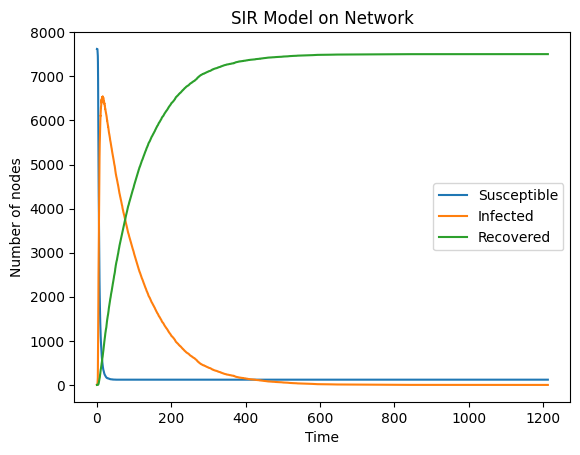

In [ ]:
import networkx as nx
import EoN
import matplotlib.pyplot as plt

# Parameters
beta = 0.2  # transmission rate
gamma = 0.01  # recovery rate
initial_infected = [1] #starting point 
G = nx.convert_node_labels_to_integers(G, first_label=0)

# Run the SIR model on the network
t, S, I, R = EoN.fast_SIR(G, beta, gamma, initial_infecteds = initial_infected)

# Plot the results
plt.plot(t, S, label='Susceptible')
plt.plot(t, I, label='Infected')
plt.plot(t, R, label='Recovered')
plt.xlabel('Time')
plt.ylabel('Number of nodes')
plt.title('SIR Model on Network')
plt.legend()
plt.show()


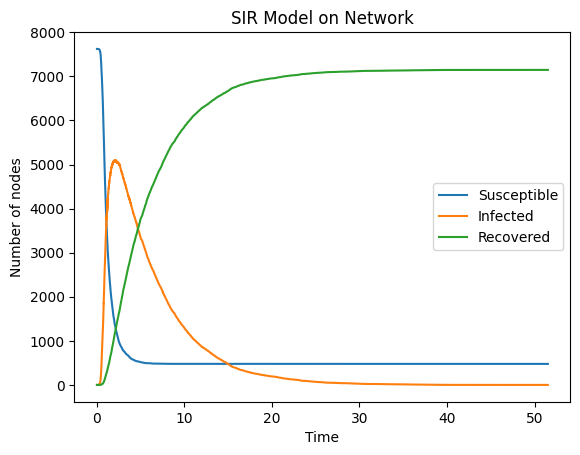

In [ ]:
import networkx as nx
import EoN
import matplotlib.pyplot as plt

# Parameters
beta = 0.9  # transmission rate
gamma = 0.2  # recovery rate
initial_infected = [1] #starting point 
G = nx.convert_node_labels_to_integers(G, first_label=0)

# Run the SIR model on the network
t, S, I, R = EoN.fast_SIR(G, beta, gamma, initial_infecteds = initial_infected)

# Plot the results
plt.plot(t, S, label='Susceptible')
plt.plot(t, I, label='Infected')
plt.plot(t, R, label='Recovered')
plt.xlabel('Time')
plt.ylabel('Number of nodes')
plt.title('SIR Model on Network')
plt.legend()
plt.show()


In [ ]:
R/(R+S)

array([0.        , 0.        , 0.        , ..., 0.937418  , 0.93742621,
       0.93743442])

In [ ]:

from networkx.algorithms import community

# Detect communities using Louvain method
communities = community.overlap_label_propagation_communities(G)

# Convert the communities to a list for further analysis
communities_list = [list(community) for community in communities]

sorted_communities = sorted(communities_list, key=len, reverse=True)

# Extract the top 10 communities
top_10_communities = sorted_communities[:10]

# Print the top 10 communities
print("Top 10 Communities:", top_10_communities)

# Calculate modularity
modularity = community.modularity(G, communities)
print("Modularity:", modularity)





AttributeError: module 'networkx.algorithms.community' has no attribute 'overlap_label_propagation_communities'

In [ ]:
len(top_10_communities[9])

124

In [13]:
import igraph as ig

ig_graph = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())

# Detect overlapping communities using Label Propagation algorithm in igraph
communities = ig_graph.community_label_propagation()

# Print the detected communities
print("Communities:", communities)

# Convert the communities to a list for further analysis
communities_list = [list(community) for community in communities]

# Visualize the graph with communities
ig.plot(ig_graph, vertex_color=communities.membership)

Communities: Clustering with 7624 elements and 174 clusters
[  0] 0, 1, 261, 262, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274,
      361, 362, 363, 451, 452, 453, 454, 455, 530, 606, 607, 608, 609, 610,
      611, 612, 614, 615, 616, 617, 618, 619, 620, 621, 626, 629, 971, 1166,
      1167, 1168, 1169, 1170, 1171, 1498, 1499, 1589, 1590, 1591, 1592, 1593,
      1594, 1595, 1596, 1631, 1632, 1671, 1672, 1673, 1674, 1675, 1676, 1677,
      1834, 1835, 1836, 1837, 1838, 1839, 1840, 1841, 1842, 1843, 1845, 1846,
      1847, 1848, 1849, 1850, 1851, 1868, 1869, 1870, 1871, 1872, 2001, 2245,
      2246, 2247, 2299, 2300, 2302, 2303, 2305, 2306, 2307, 2308, 2309, 2321,
      2322, 2636, 2637, 2638, 2639, 2640, 2641, 2642, 2643, 2644, 2645, 2646,
      2647, 2755, 2902, 2903, 2904, 2905, 2906, 2908, 2910, 2911, 2912, 2913,
      2914, 2947, 2954, 2955, 2956, 3031, 3032, 3112, 3113, 3160, 3161, 3174,
      3175, 3274, 3287, 3318, 3353, 3354, 3360, 3361, 3390, 3432, 3444, 3616,
      36

In [14]:
sorted_communities = sorted(communities_list, key=len, reverse=True)

# Extract the top 10 communities
top_10_communities = sorted_communities[:10]


In [16]:
len(top_10_communities[9])

240

In [ ]:
# overlapping communities? is our first algorithm okay as it is not detecting them
# we can use our first algorithm -> any actually can work
# doing it many times and getting the average
# try to see S->R for certain steps try S->R because we are updateing the software 